# Questions to reviewers
This is second submission. I got a lot of help from first review, thanks!!!

Still, i have a few questions:
1. the first reviewer mentioned Xavier weight initialization; but i didn't find how to use it in code. is it already in tensorflow?
2. the first reviewer recommended "low drop_rate", i used 0.5 here. did you mean we should drop little and keep much?
3. the first reviewer recommended D: 64 -> 128 -> 256, G:512->256->128->color channel; here i used d: 14x14x64 -> 7x7x128 -> 4x4x256 and g: 7x7x512 -> 14x14x256->28x28x128->28x28x channel. at last step of generator i didn't change image size. did my converions make sense?  what are the normally accepted hyper parameters in this project?
4. my mentor told me that i might try (strides=1, padding='valid') to convert 4x4 to 7x7; he said it is all about data manipulation; which i agree.  i remember in previous videos it was mentioned that in general padding='same' works; so here i stick with 'same'.  should i also try 'valid', while focusing on image sizes?  // i can try various parameters by myself, but i am not sure how much i should generalize my observations.  so here i am asking you. thanks!
5. my training results don't look like the best to me, especially for face generation, i occassionally see ghost faces; and it seems to me that the training cannot produce ideal results in near epochs. is it expected for our project? what we may be able to do if training does not go well as expected?
6. may we use different learning rate for D and G? here we use drop out for D, we worry about its overfitting; if so, may we use a smaller learning rate for D?
7. we use beta1 in AdamOptimizer; we divide all images into multi batches; does this mean we train the model on different batches using different learning rate?  // the project code first create a placeholder for learning rate; but later pass a float learning rate into optimizers; so the placeholder is not really used. my question is: is it reasonable to go back to use a larger learning rate at the beginning of each epoch -- with the hope of jumping out of local optima-- and then inside each epoch the learning rate gets smaller and smaller? does anyone do this?
... ... thanks!

# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot


(25, 28, 28, 1)


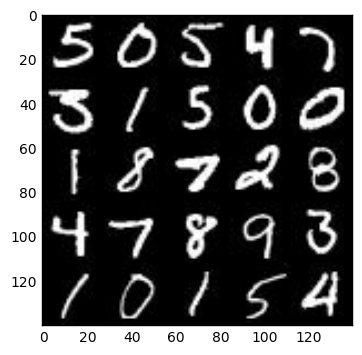

In [3]:
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
print(mnist_images.shape)

pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

In [4]:
print(mnist_images[0].max())


255.0


### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

(25, 28, 28, 3)


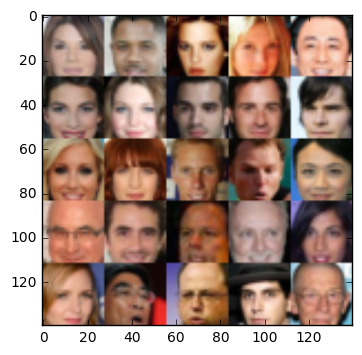

In [5]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
celeba_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')

pyplot.imshow(helper.images_square_grid(celeba_images, 'RGB'))

print(celeba_images.shape)

In [6]:
print(celeba_images[0].max())

254.0


## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [7]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.3.0


/home/ubuntu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [8]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    real_input = tf.placeholder(tf.float32, [None, image_height, image_width, image_channels], name='real_input')
    z_data = tf.placeholder(tf.float32, [None, z_dim], name='z_data')
    lr = tf.placeholder(dtype=tf.float32, name='learning_rate')
    return real_input, z_data, lr


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.framework.ops.Operation'>):
<tf.Operation 'assert_rank_2/Assert/Assert' type=Assert>
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
['File "/home/ubuntu/anaconda3/lib/python3.5/runpy.py", line 193, in _run_module_as_main\n    "__main__", mod_spec)', 'File "/home/ubuntu/anaconda3/lib/python3.5/runpy.py", line 85, in _run_code\n    exec(code, run_globals)', 'File "/home/ubuntu/anaconda3/lib/python3.5/site-packages/ipykernel/__main__.py", line 3, in <module>\n    app.launch_new_instance()', 'File "/home/ubuntu/anaconda3/lib/python3.5/site-packages/traitlets/config/application.py", line 653, in launch_instance\n    app.start()', 'File "/home/ubuntu/anaconda3/lib/python3.5/site-packages/ipykernel/kernelapp.py", line 474, in start\n    ioloop.IOLoop.instance().start()', 'File "/home/ubuntu/anaconda3/lib/python3.5/site-packages/zmq/eventloop/

### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [11]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # copy the structure from DCGAN code: first layer output has not batch normalization
    alpha = 0.2
    dropout_rate = 0.5
    #print('in discriminator: ', images.shape)
    with tf.variable_scope('discriminator', reuse=reuse):
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        #bn1 = tf.layers.batch_normalization(x1, training=True)
        bn1 = x1
        relu1 = tf.maximum(alpha * bn1, bn1)
        d1 = tf.layers.dropout(relu1, rate=dropout_rate)
        # 14 * 14 * 64
        
        x2 = tf.layers.conv2d(d1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        d2 = tf.layers.dropout(relu2, rate=dropout_rate)
        # 7 * 7 * 128

        x3 = tf.layers.conv2d(d2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        d3 = tf.layers.dropout(relu3, rate=dropout_rate)
        # 4 * 4 * 256
        
        flatten = tf.reshape(d3, [-1, 4 * 4 * 256])
        logits = tf.layers.dense(flatten, 1)
        output = tf.sigmoid(logits)
        
    return output, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [10]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    alpha = 0.2
    #print('in generator ', z, out_channel_dim, is_train)
    with tf.variable_scope('generator', reuse= not is_train): # 'not is_train', don't play this trick
        x1 = tf.layers.dense(z, 7 * 7 * 512)
        x1 = tf.reshape(x1, [-1, 7, 7, 512])
        bn1 = tf.layers.batch_normalization(x1, training=is_train)
        relu1 = tf.maximum(alpha * bn1, bn1)
        # 7 * 7 * 512
        #print(relu1.shape)
        
        x2 = tf.layers.conv2d_transpose(relu1, 256, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=is_train)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 14 * 14 * 256
        #print(relu2.shape)

        x3 = tf.layers.conv2d_transpose(relu2, 128, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=is_train)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 28 x 28 x 128
        #print(relu3.shape)
        
        logits = tf.layers.conv2d_transpose(relu3, out_channel_dim, 5, strides=1, padding='same')
        #print(logits.shape)
        output = tf.tanh(logits)
    
    return output


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [12]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    #print('model_loss: ', input_real, input_z, out_channel_dim)
    g = generator(input_z, out_channel_dim, is_train=True)
    
    d_real, d_real_logits = discriminator(images=input_real, reuse=False)
    d_z, d_z_logits = discriminator(images=g, reuse=True)
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_real_logits, labels=tf.ones_like(d_real)*0.9))
    d_loss_z = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_z_logits, labels=tf.zeros_like(d_z)))
    d_loss = d_loss_real + d_loss_z
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_z_logits, labels=tf.ones_like(d_z)))
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    vs = tf.trainable_variables()
    vs_d = [v for v in vs if v.name.startswith('discriminator')]
    vs_g = [v for v in vs if v.name.startswith('generator')]
    
    #serious, i don't know what this is doing; and didn't have time going into it
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(d_loss, var_list=vs_d)
        g_train_opt = tf.train.AdamOptimizer(learning_rate=learning_rate, beta1=beta1).minimize(g_loss, var_list=vs_g)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [14]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    why pass a z tensor ?
    TypeError: The value of a feed cannot be a tf.Tensor object. Acceptable feed values include Python scalars, strings, lists, numpy ndarrays, or TensorHandles.
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [15]:
global samples
samples = []
global losses
losses = []

In [16]:
print(losses)

[]


In [17]:
mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))

In [22]:
m100=next(mnist_dataset.get_batches(100))
c100=next(celeba_dataset.get_batches(100))
print(m100.min(), m100.max())
print(c100.min(), c100.max())
m100 = m100 * 2
c100 = c100 * 2
print(m100.min(), m100.max())
print(c100.min(), c100.max())

-0.5 0.5
-0.5 0.5
-1.0 1.0
-1.0 1.0


In [24]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    #saver = tf.train.Saver()
    #z0 = np.random.uniform(-1, 1, size=(1, z_dim)) # np.random has no get_shape()
    z0 = tf.random_uniform((4, z_dim), -1, 1, dtype=tf.float32)
    #samples, losses = [], []
    losses=[]
    
    image_channels = 1 if data_image_mode == 'L' else 3
    print(' set up in train() ', data_shape[0], data_shape[1], image_channels, z_dim)
    print(' in train(), data_shape: ', data_shape)
    real_input, z_data, lr = model_inputs(data_shape[1], data_shape[2], image_channels, z_dim)
    d_loss, g_loss = model_loss(tf.cast(real_input, tf.float32), z_data, image_channels)
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    step = 0
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            step = 0
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                #print(' a batch', batch_images.shape)
                #print(' data ', batch_images[0]) # so, the real_input is already normalized!
                batch_images = batch_images * 2
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                _ = sess.run([d_train_opt, g_train_opt], feed_dict={real_input:batch_images, z_data:batch_z, lr:learning_rate})
                #w2 = sess.run(g_train_opt, feed_dict={real_input:batch_images, z_data:batch_z, lr:learning_rate})
                step += 1
                if step % 100 == 0:
                    d_loss_, g_loss_ = sess.run([d_loss, g_loss], feed_dict={real_input:batch_images, z_data:batch_z, lr:learning_rate})
                    losses += [(d_loss_, g_loss_)]
                    print(d_loss_, g_loss_, step*batch_size, epoch_i+1)
                    show_generator_output(sess, 4, z0, data_shape[-1], data_image_mode)
                #    print('...', step)
                #print(w1, w2)
            # print eval 
        show_generator_output(sess, 36, tf.random_uniform((36, z_dim), -1, 1, dtype=tf.float32), data_shape[-1], data_image_mode)
        show_generator_output(sess, 36, tf.random_uniform((36, z_dim), -1, 1, dtype=tf.float32), data_shape[-1], data_image_mode)
        #saver.save(sess, './checkpoints/generator.ckpt')
    return losses
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

 set up in train()  60000 28 1 128
 in train(), data_shape:  (60000, 28, 28, 1)
2.07124 0.287007 3200 1


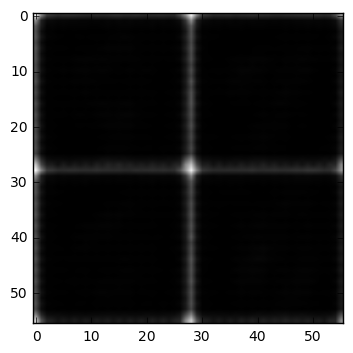

2.09143 0.234971 6400 1


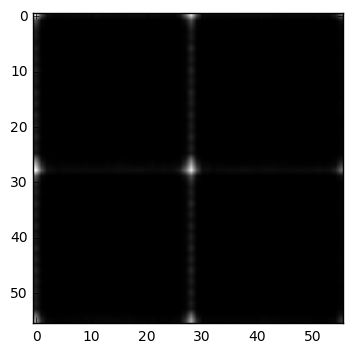

1.09231 1.93195 9600 1


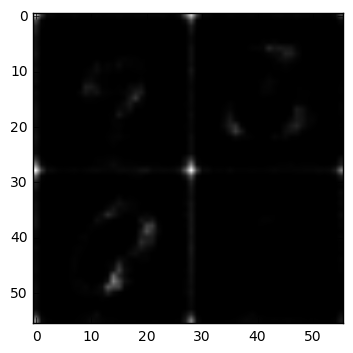

1.04005 1.58074 12800 1


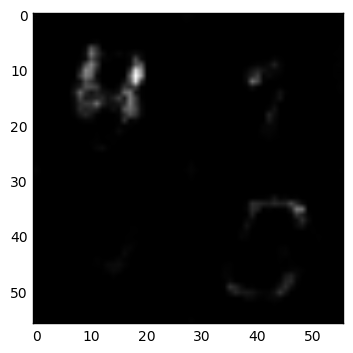

0.913967 1.44456 16000 1


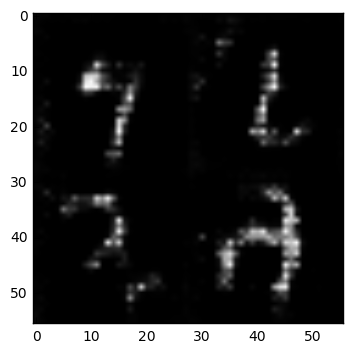

1.19193 1.62882 19200 1


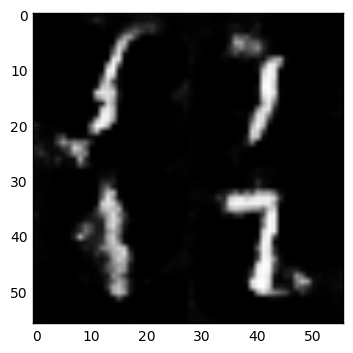

0.826861 1.06244 22400 1


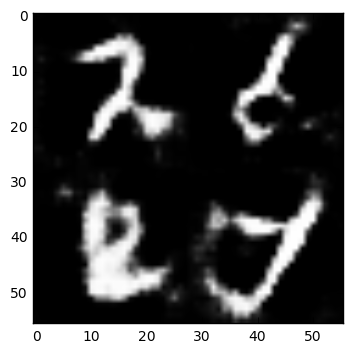

0.814637 1.20059 25600 1


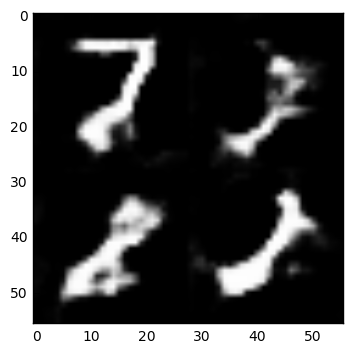

0.971588 0.941281 28800 1


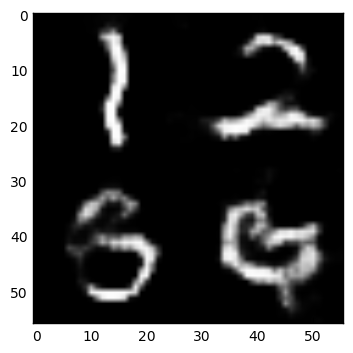

1.03591 1.44329 32000 1


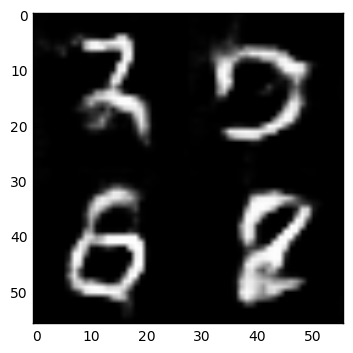

0.907376 1.32982 35200 1


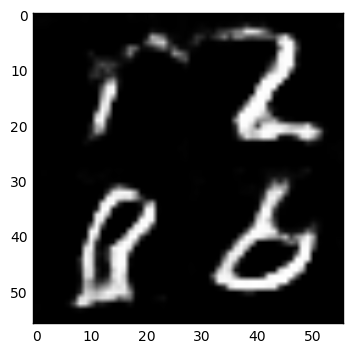

1.48363 0.441994 38400 1


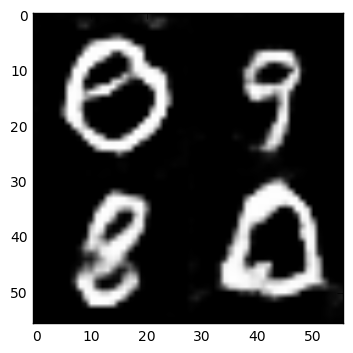

1.26385 0.602402 41600 1


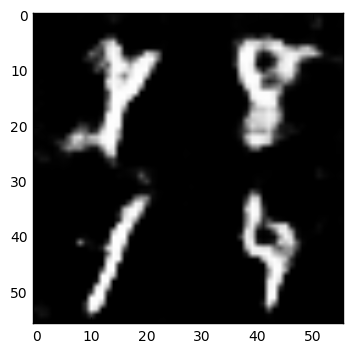

1.70719 0.332294 44800 1


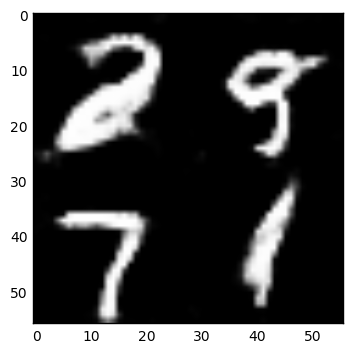

1.66485 0.379218 48000 1


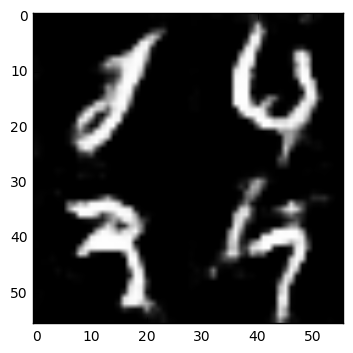

1.14613 0.786625 51200 1


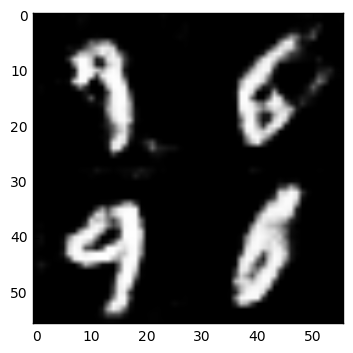

1.27454 2.98805 54400 1


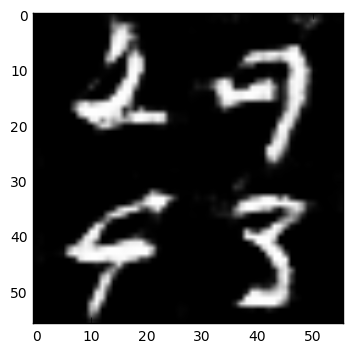

1.32323 0.517463 57600 1


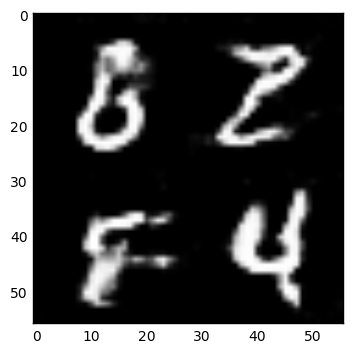

1.20566 0.696075 3200 2


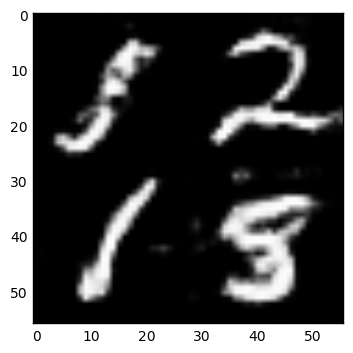

1.04595 0.813368 6400 2


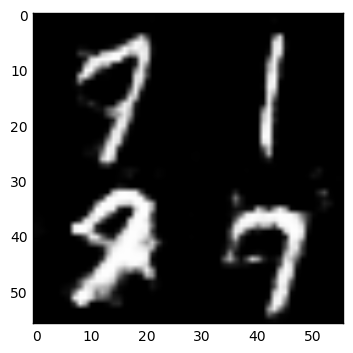

0.760422 1.37847 9600 2


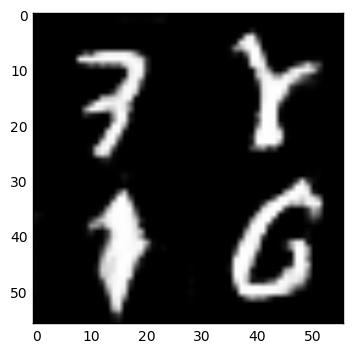

0.749809 1.38215 12800 2


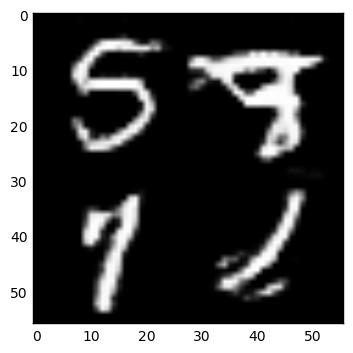

1.0107 0.840046 16000 2


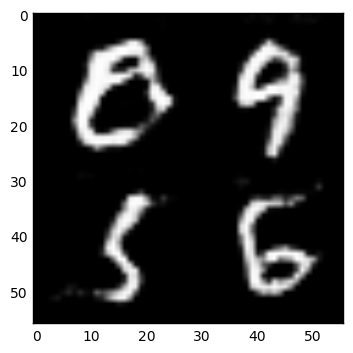

0.977048 0.941843 19200 2


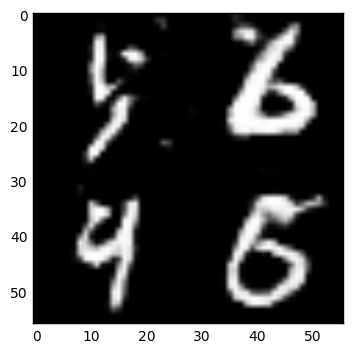

0.749155 1.3467 22400 2


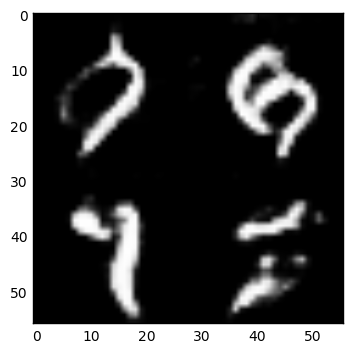

0.759177 1.47682 25600 2


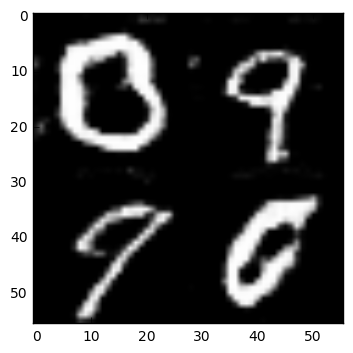

0.836523 1.29152 28800 2


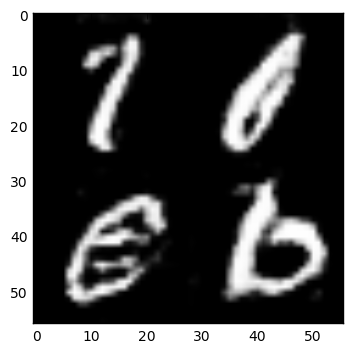

0.799956 1.93023 32000 2


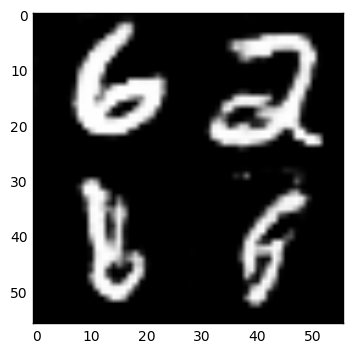

0.963155 2.15683 35200 2


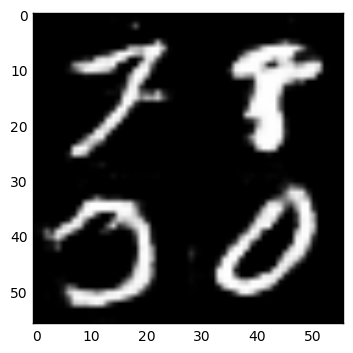

0.75642 1.36336 38400 2


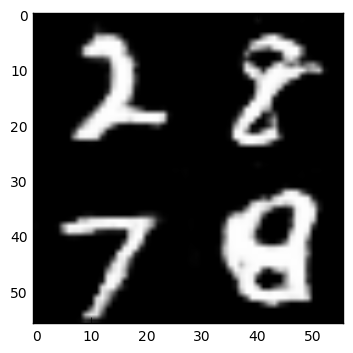

0.873886 1.22429 41600 2


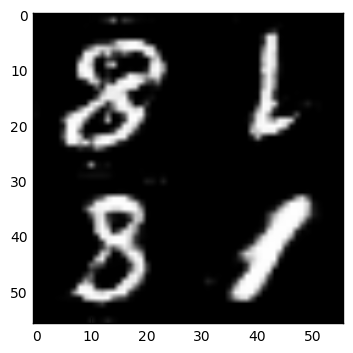

0.853123 1.19103 44800 2


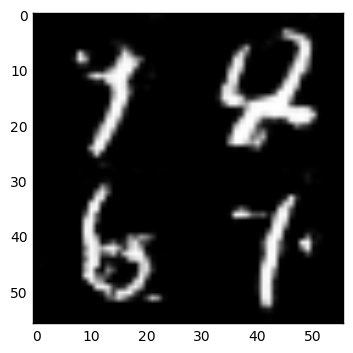

1.57621 0.457739 48000 2


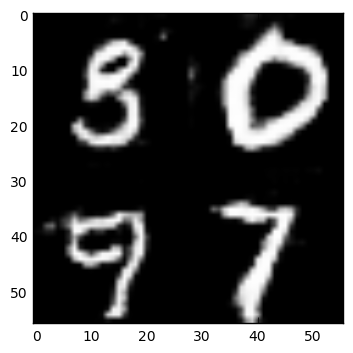

0.828955 1.83757 51200 2


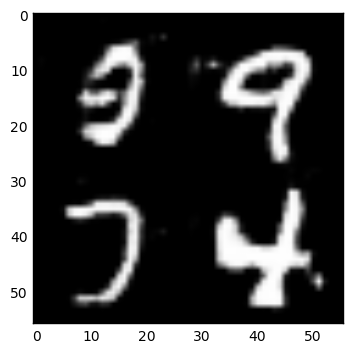

0.569352 1.81394 54400 2


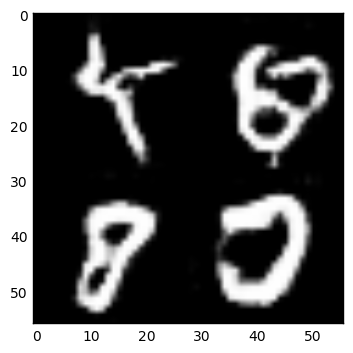

1.83612 0.36649 57600 2


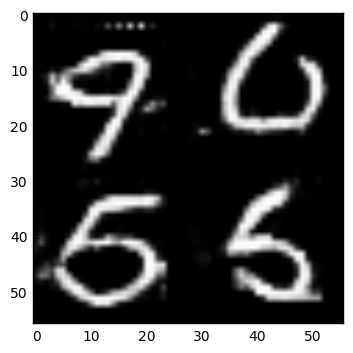

0.896781 1.14139 3200 3


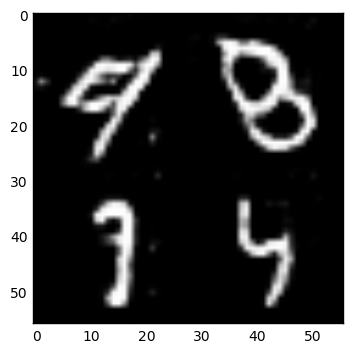

0.71235 1.41001 6400 3


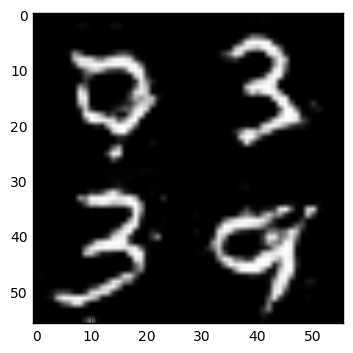

0.557516 2.18017 9600 3


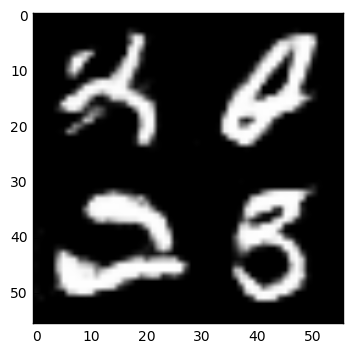

0.77915 1.28779 12800 3


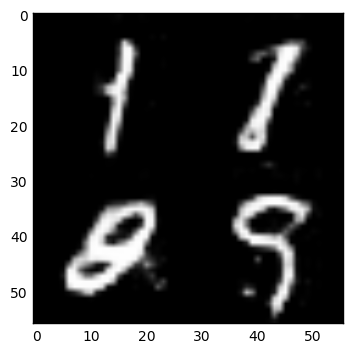

0.817966 1.21829 16000 3


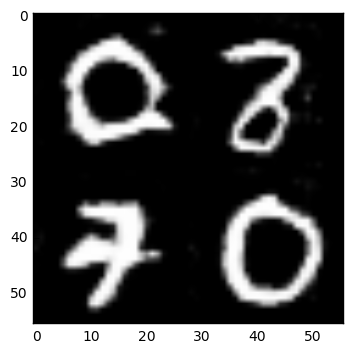

0.860518 1.07755 19200 3


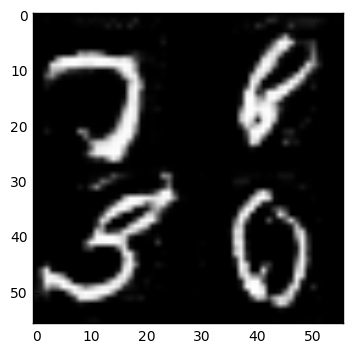

0.680237 1.6647 22400 3


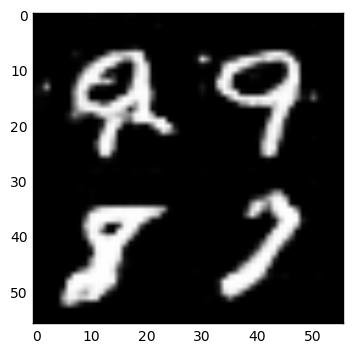

0.6309 1.54587 25600 3


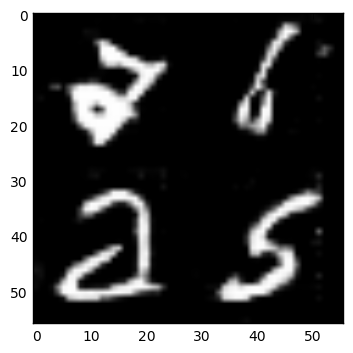

0.546233 1.92494 28800 3


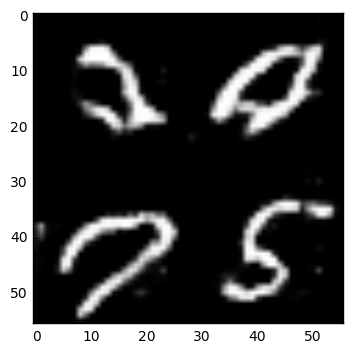

0.717002 1.67624 32000 3


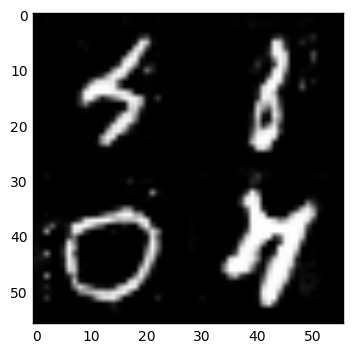

0.745953 1.38614 35200 3


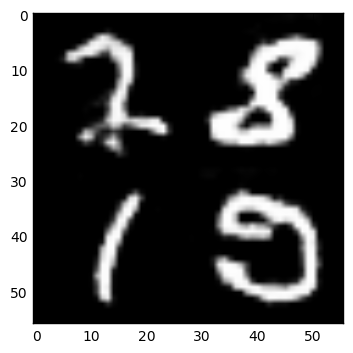

0.707466 1.38965 38400 3


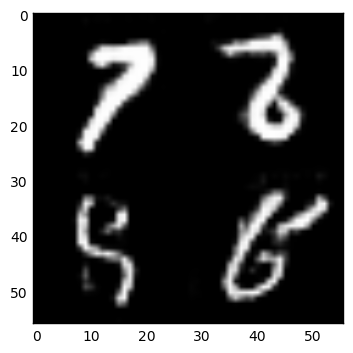

0.594877 2.1809 41600 3


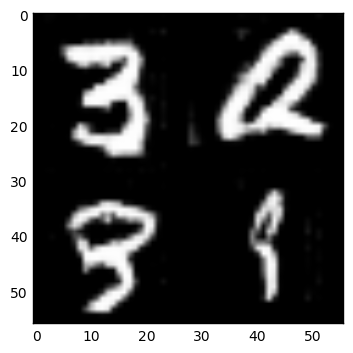

0.819925 1.09846 44800 3


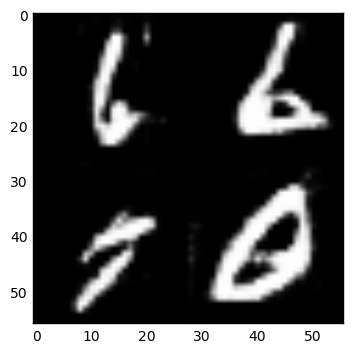

1.21565 0.649385 48000 3


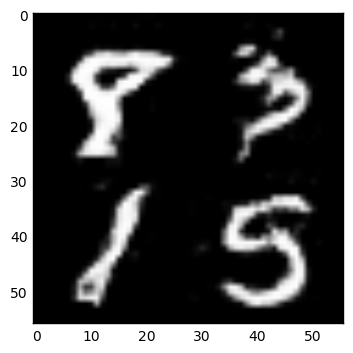

0.825667 1.52523 51200 3


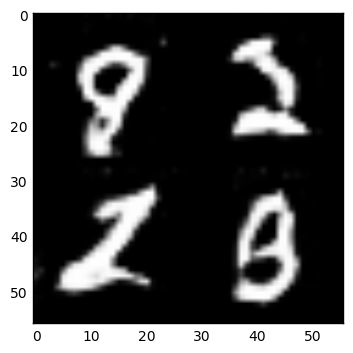

0.693642 1.43524 54400 3


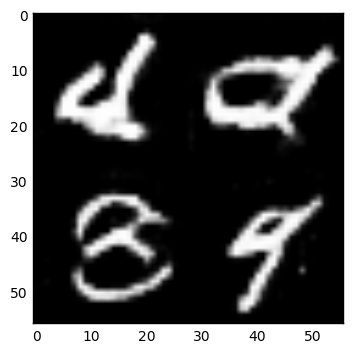

0.616191 1.71723 57600 3


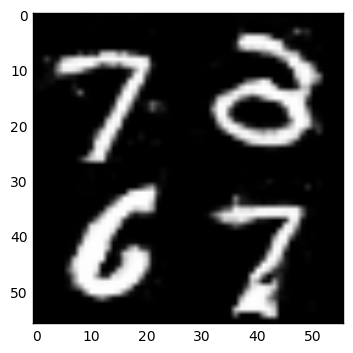

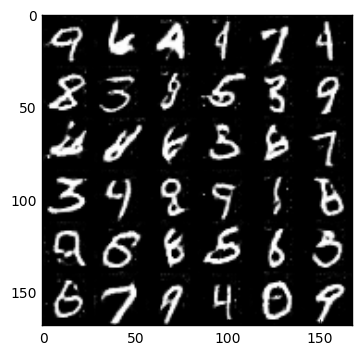

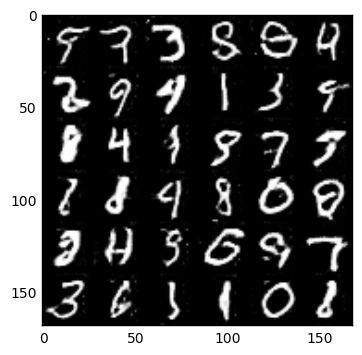

CPU times: user 14h 33min 42s, sys: 2h 39min 29s, total: 17h 13min 11s
Wall time: 2h 44min 56s


In [26]:
%%time

batch_size = 32
z_dim = 128
learning_rate = 0.0002
beta1 = 0.2 # 0.1 -- 0.3

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 3
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

 set up in train()  202599 28 3 128
 in train(), data_shape:  (202599, 28, 28, 3)
0.922591 1.40341 3200 1


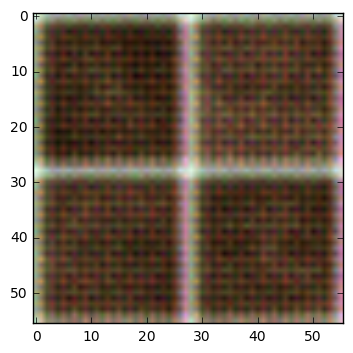

0.753051 1.93265 6400 1


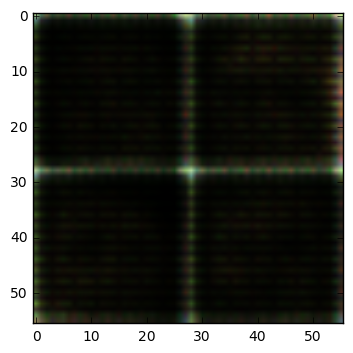

0.415112 3.28648 9600 1


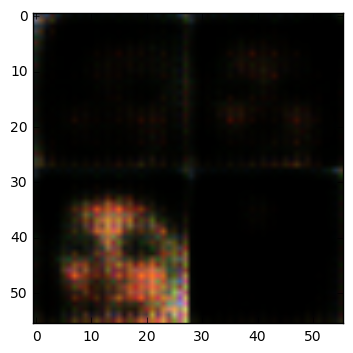

0.726686 1.30677 12800 1


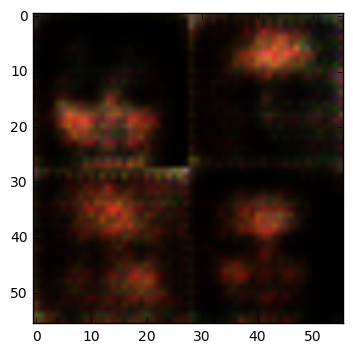

0.872082 0.981319 16000 1


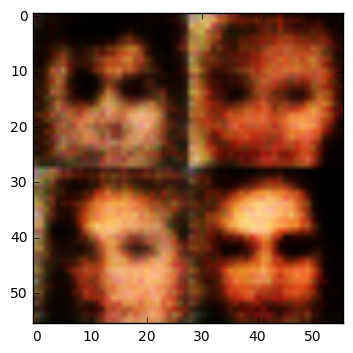

2.18663 2.6698 19200 1


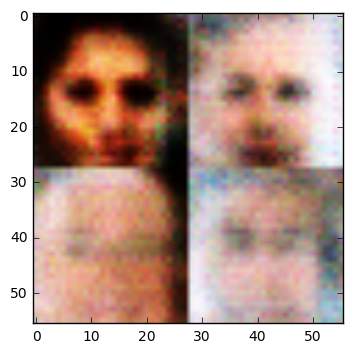

1.04571 1.57308 22400 1


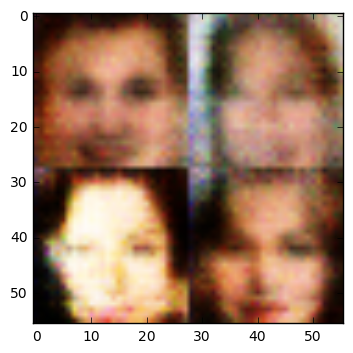

1.20897 2.4053 25600 1


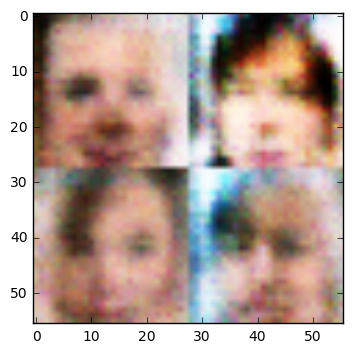

0.473232 2.40633 28800 1


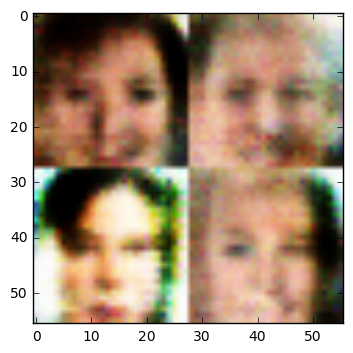

1.49321 0.467255 32000 1


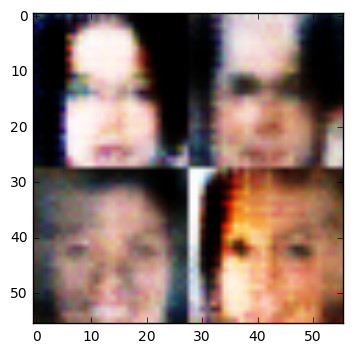

0.471014 2.38519 35200 1


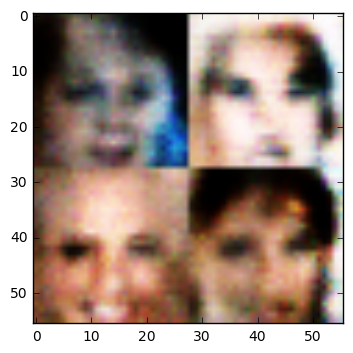

0.66014 3.49686 38400 1


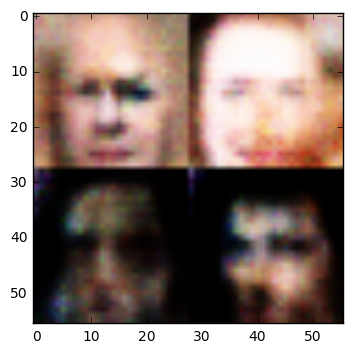

0.353756 4.62918 41600 1


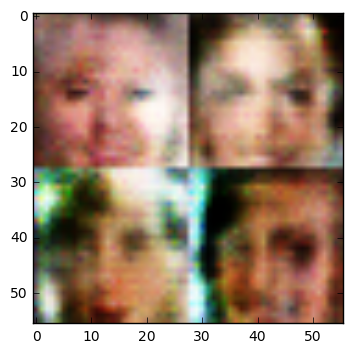

0.840078 0.991883 44800 1


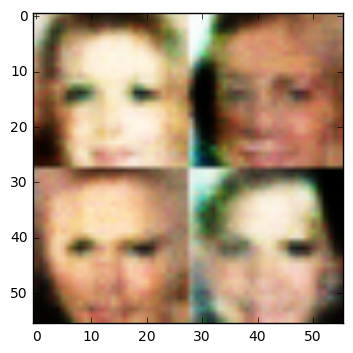

1.61638 0.359203 48000 1


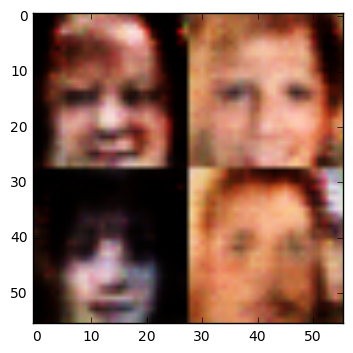

0.710831 1.25258 51200 1


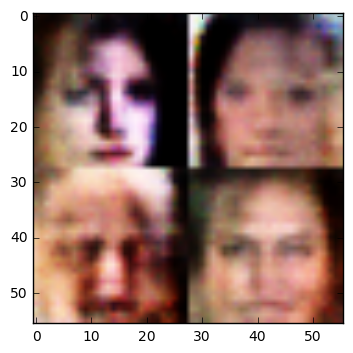

0.397286 3.63397 54400 1


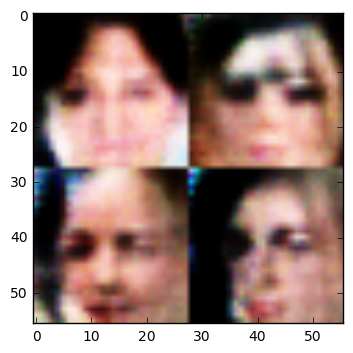

0.381059 3.82762 57600 1


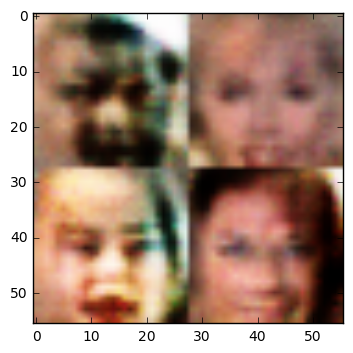

0.452595 4.86189 60800 1


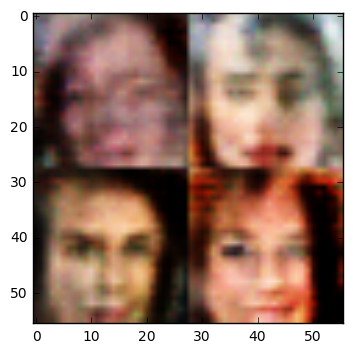

0.360314 4.2975 64000 1


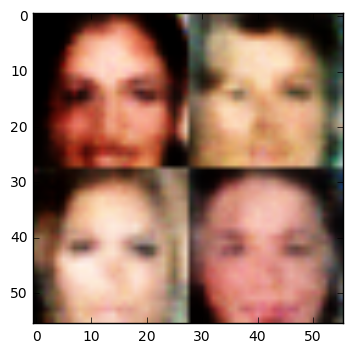

1.13754 1.37282 67200 1


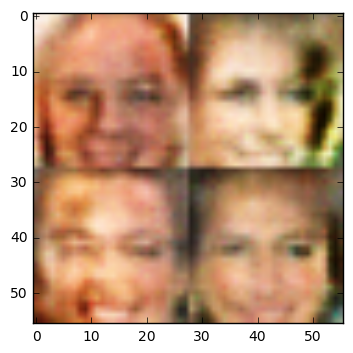

0.408565 2.89668 70400 1


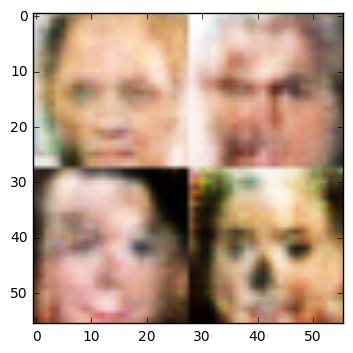

0.703033 1.37773 73600 1


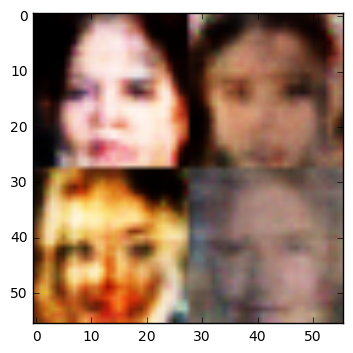

0.473674 2.3762 76800 1


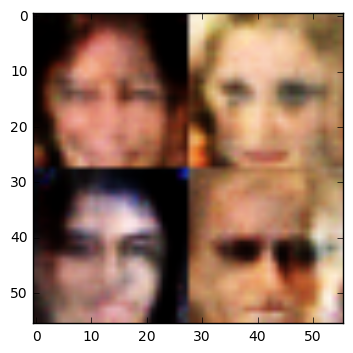

0.469886 3.77223 80000 1


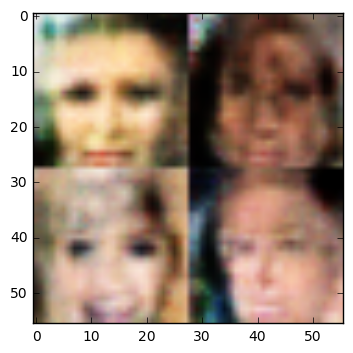

1.48404 0.456657 83200 1


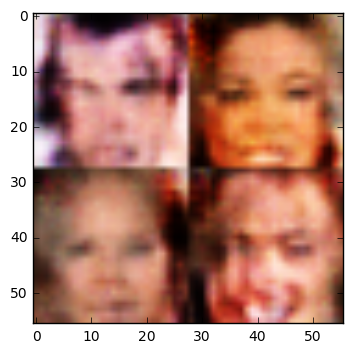

1.08682 0.798963 86400 1


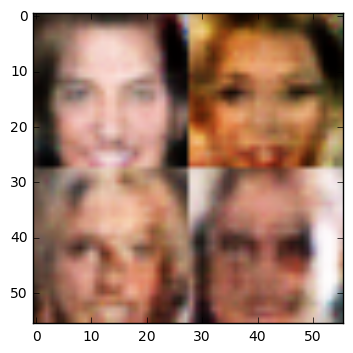

0.550621 1.86176 89600 1


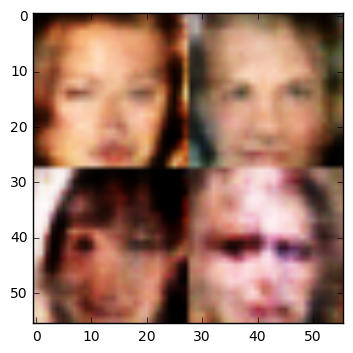

0.360434 3.97513 92800 1


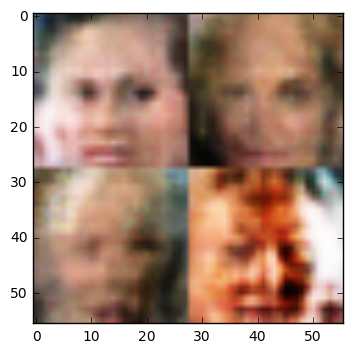

0.410165 4.13078 96000 1


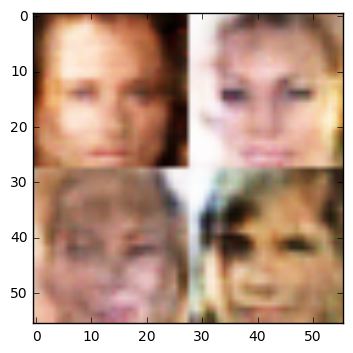

0.635996 1.53849 99200 1


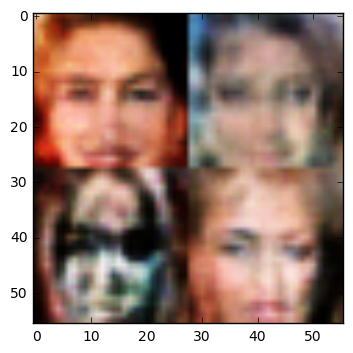

0.369124 3.90676 102400 1


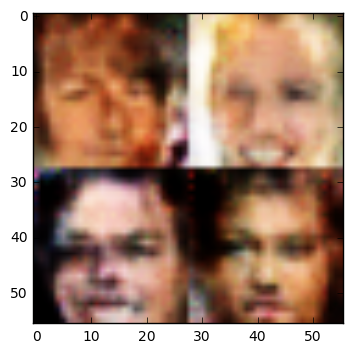

0.678336 1.63752 105600 1


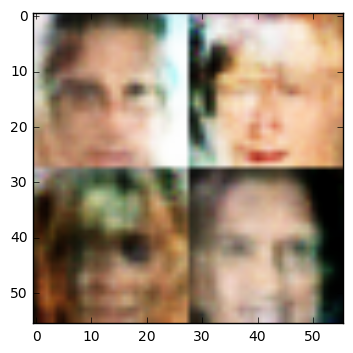

0.893578 1.37353 108800 1


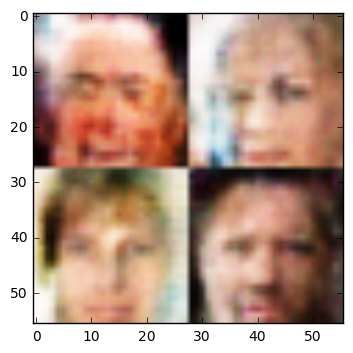

0.37252 4.05614 112000 1


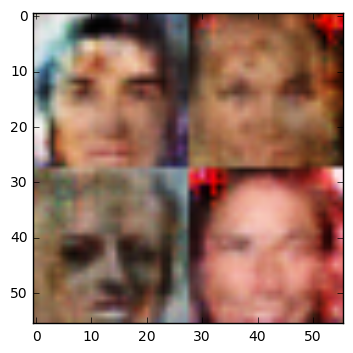

0.765882 2.66277 115200 1


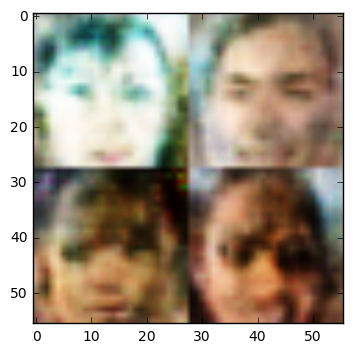

0.354299 4.17338 118400 1


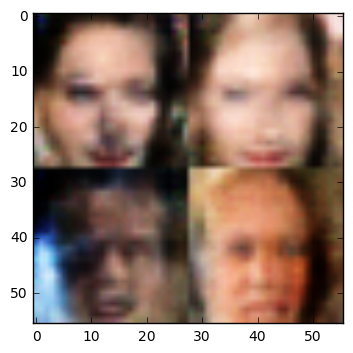

0.606942 1.67984 121600 1


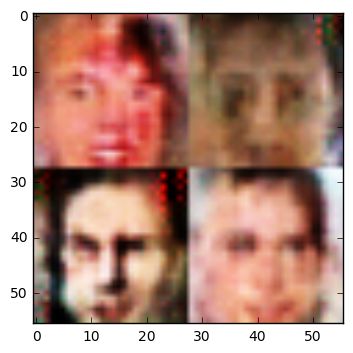

2.39465 0.185512 124800 1


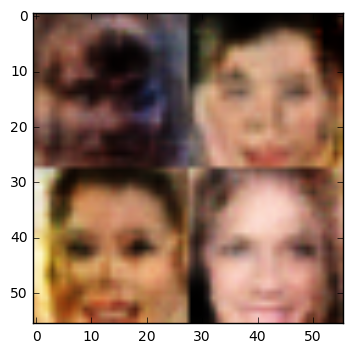

1.18295 0.669384 128000 1


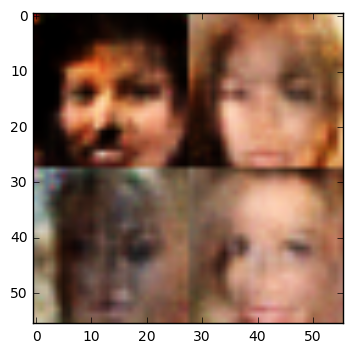

1.20253 0.651477 131200 1


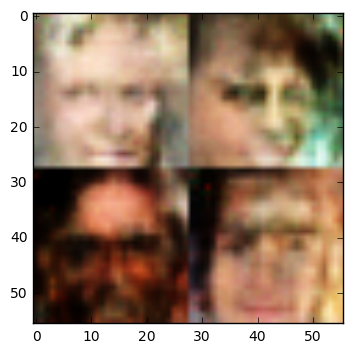

0.777837 1.23007 134400 1


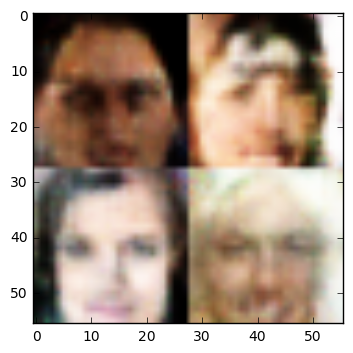

0.529439 2.3345 137600 1


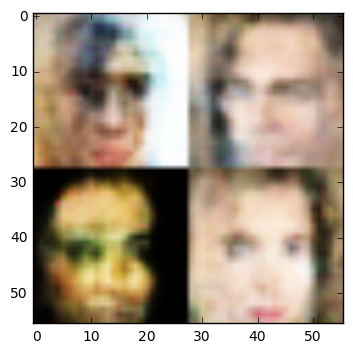

0.362795 3.85329 140800 1


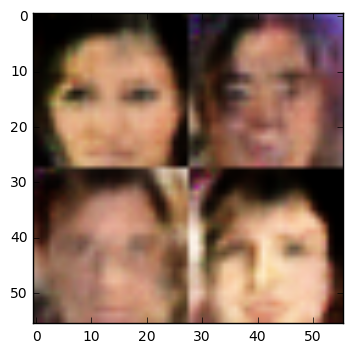

0.415912 2.84159 144000 1


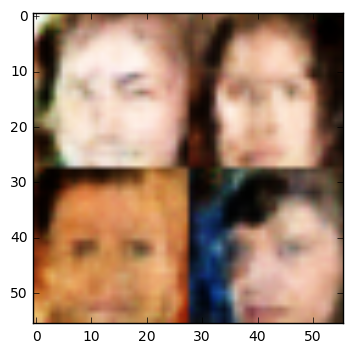

0.474551 3.0027 147200 1


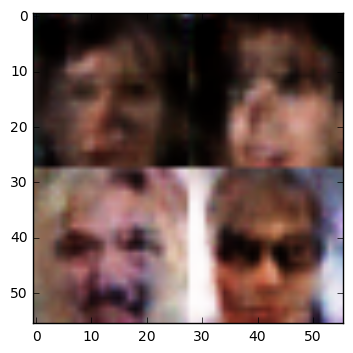

0.431139 2.86904 150400 1


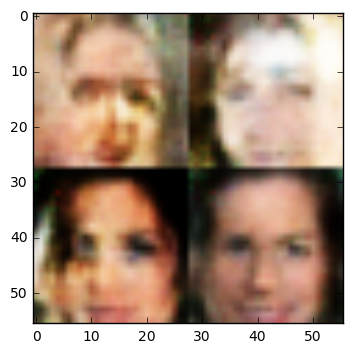

0.417082 3.07437 153600 1


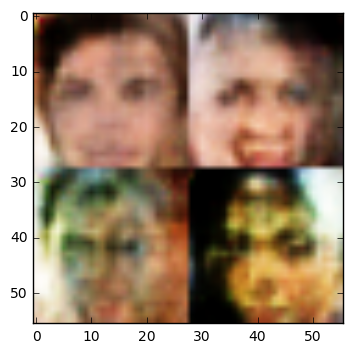

0.457177 3.03707 156800 1


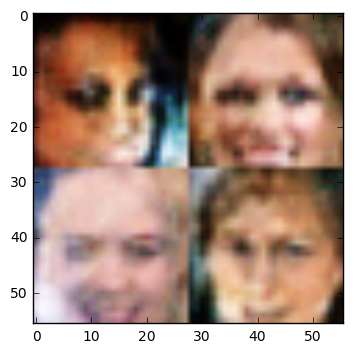

0.646421 2.72552 160000 1


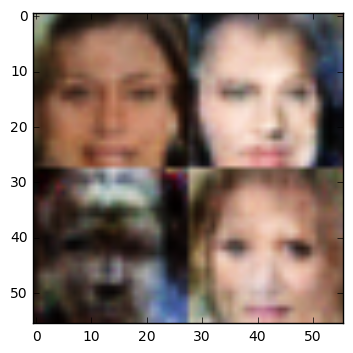

1.33083 2.96944 163200 1


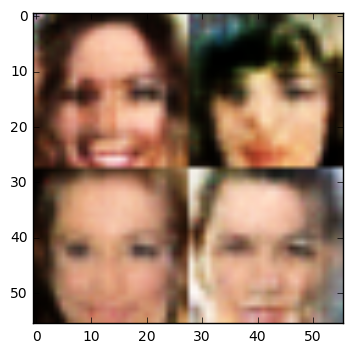

0.737265 1.28683 166400 1


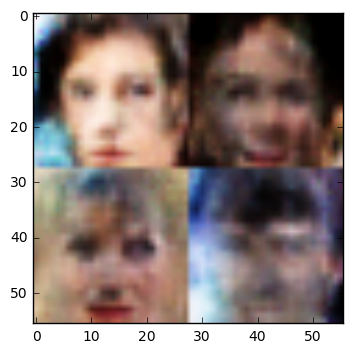

0.388725 3.53494 169600 1


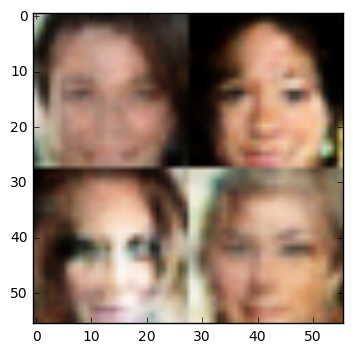

0.570837 1.83021 172800 1


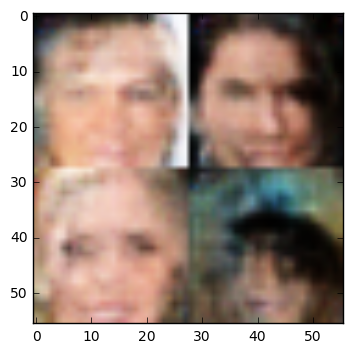

0.836103 2.49269 176000 1


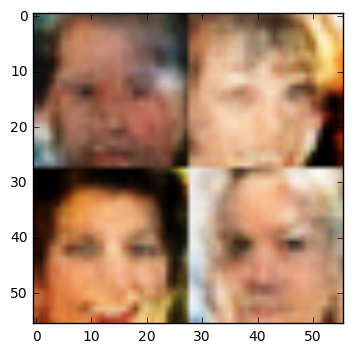

0.439865 2.76202 179200 1


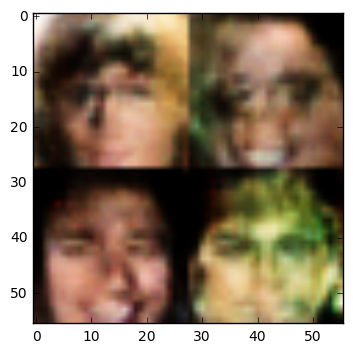

0.354848 4.4716 182400 1


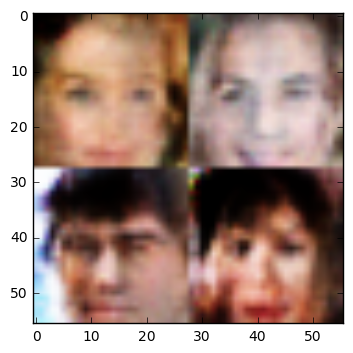

0.721647 1.28872 185600 1


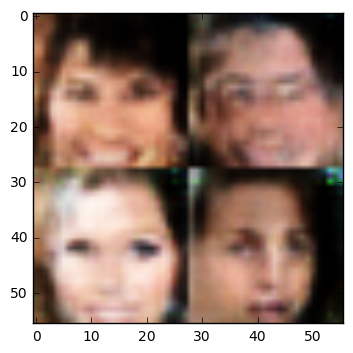

1.23675 2.97212 188800 1


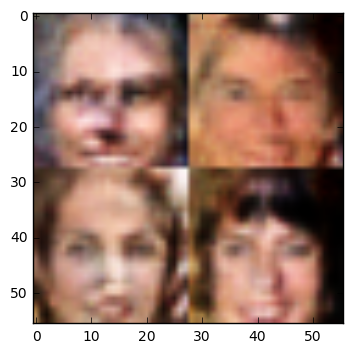

1.35786 0.517222 192000 1


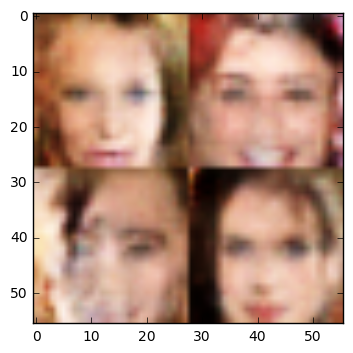

1.14112 3.91459 195200 1


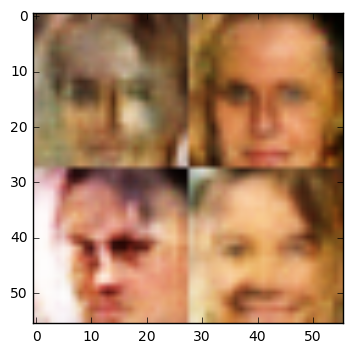

0.599916 3.25568 198400 1


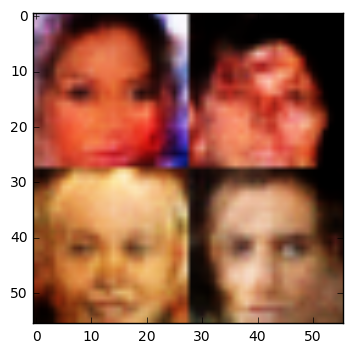

0.694074 2.26126 201600 1


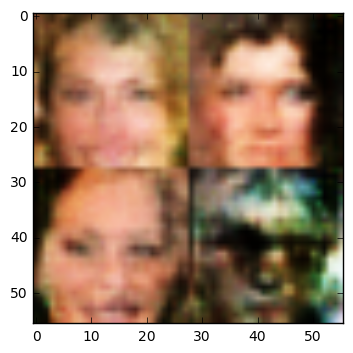

0.732963 1.43208 3200 2


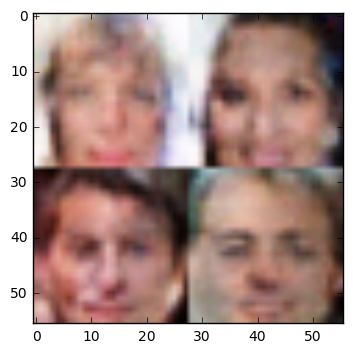

0.356696 4.24454 6400 2


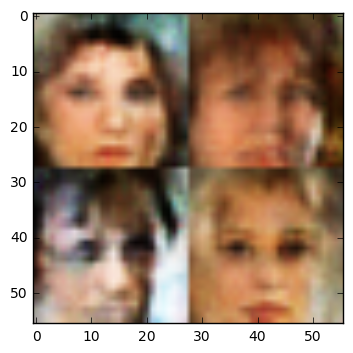

0.547754 8.35386 9600 2


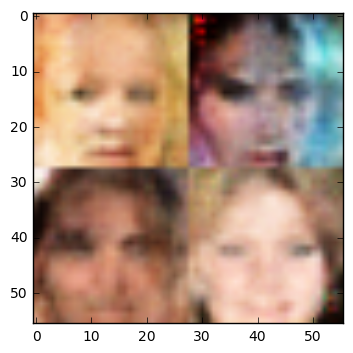

0.925071 0.960912 12800 2


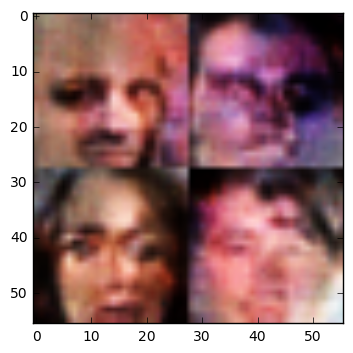

0.404751 2.90221 16000 2


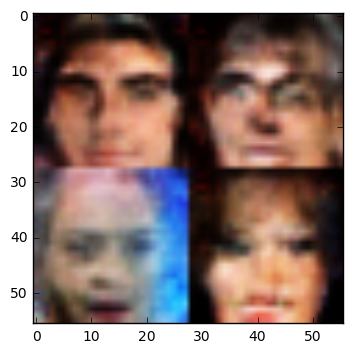

0.551897 1.77668 19200 2


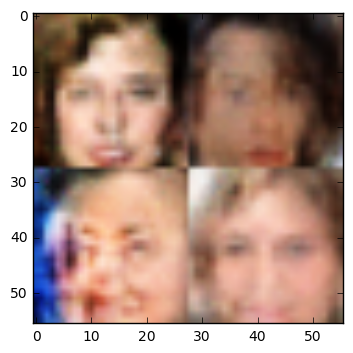

0.641894 1.66375 22400 2


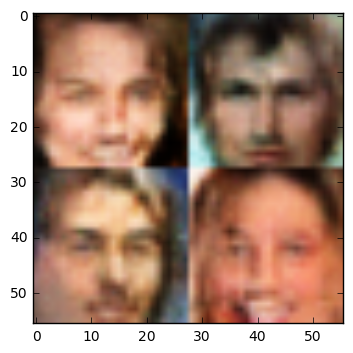

0.659118 1.44689 25600 2


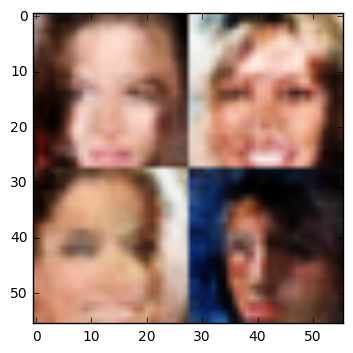

0.841412 3.6716 28800 2


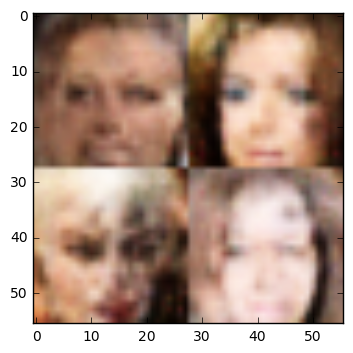

0.40212 2.87567 32000 2


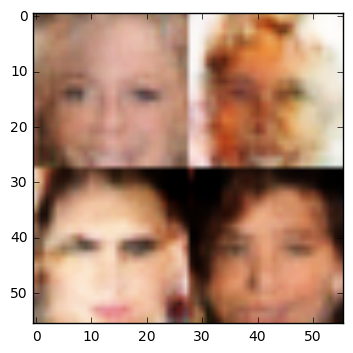

0.350812 4.44791 35200 2


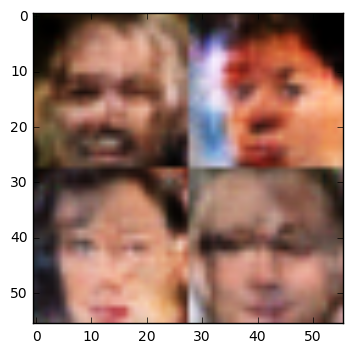

0.342956 7.08029 38400 2


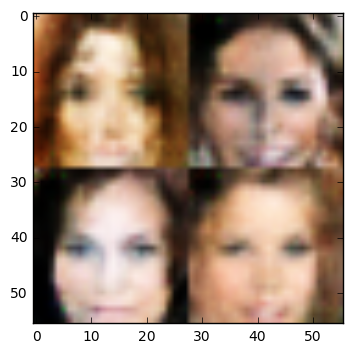

0.600443 3.79865 41600 2


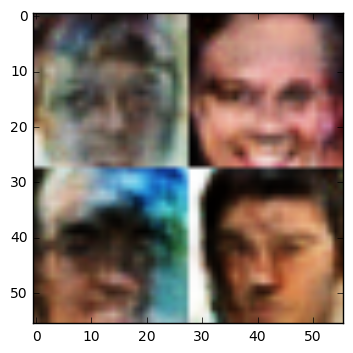

1.17965 0.609157 44800 2


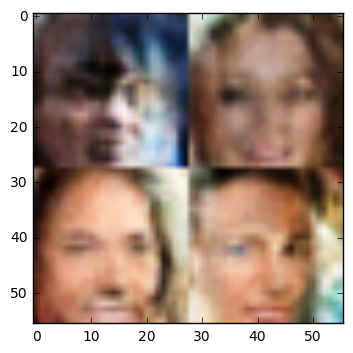

0.622146 1.75481 48000 2


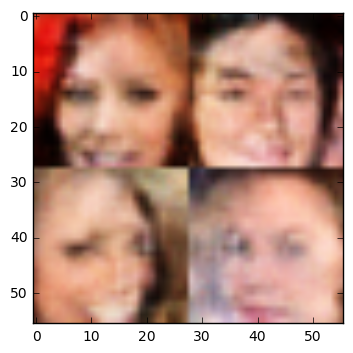

0.628964 2.51355 51200 2


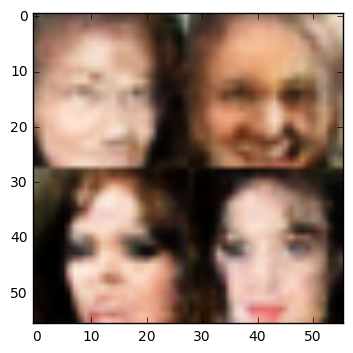

0.352066 4.52837 54400 2


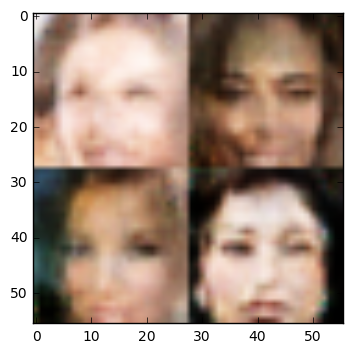

0.387589 3.54135 57600 2


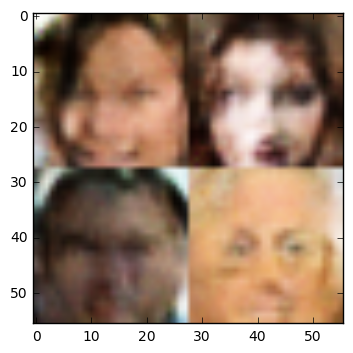

0.821347 1.11135 60800 2


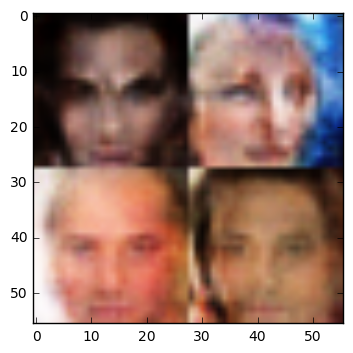

1.14604 3.01676 64000 2


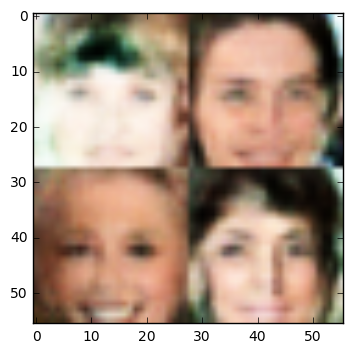

0.542385 1.91285 67200 2


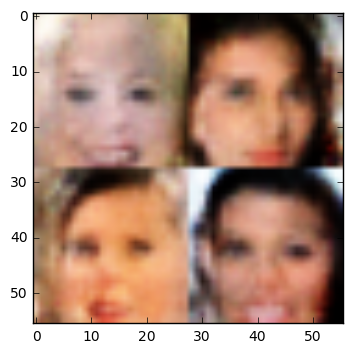

0.400776 3.21364 70400 2


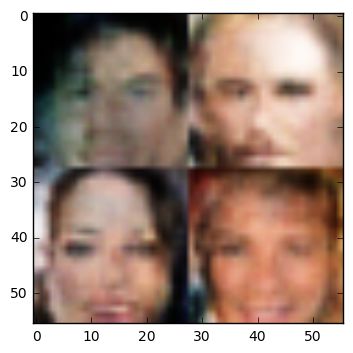

0.678545 1.78814 73600 2


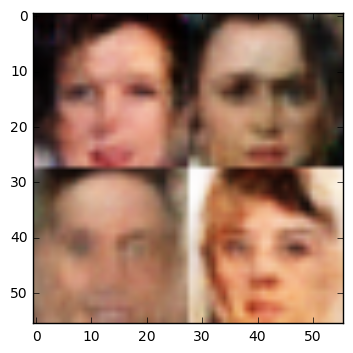

0.514227 1.88419 76800 2


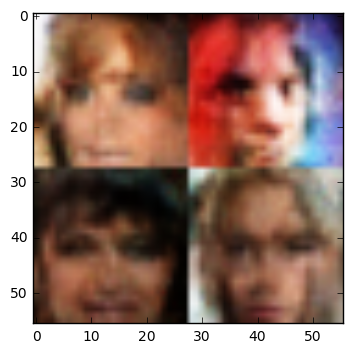

1.15624 0.680606 80000 2


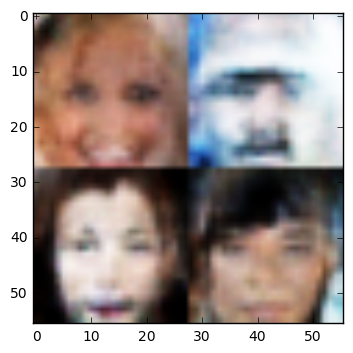

0.467165 2.45228 83200 2


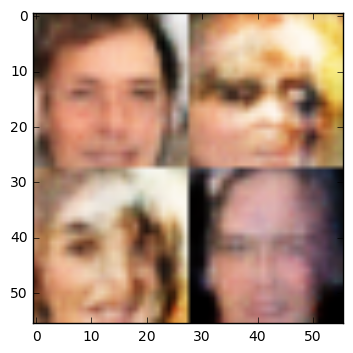

0.84415 1.0424 86400 2


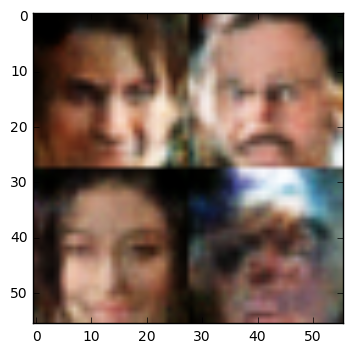

2.45868 4.63356 89600 2


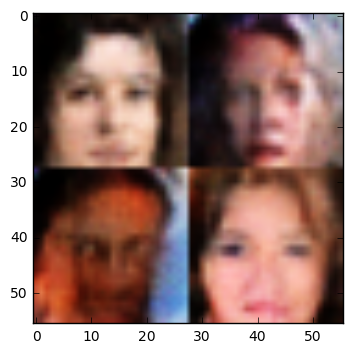

0.916025 2.56712 92800 2


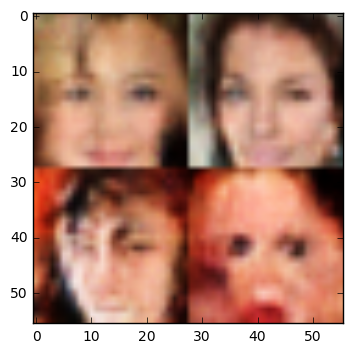

0.526971 2.15984 96000 2


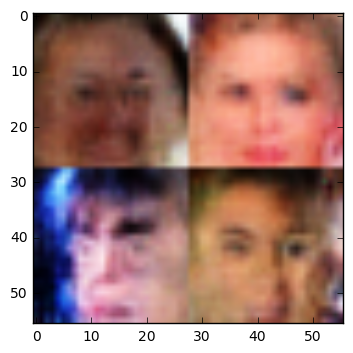

0.528607 2.09029 99200 2


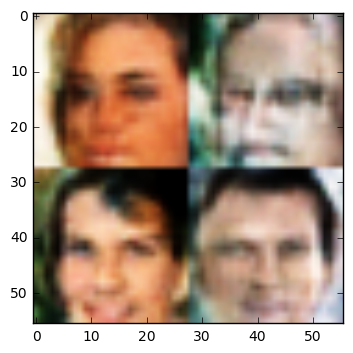

0.33797 8.12773 102400 2


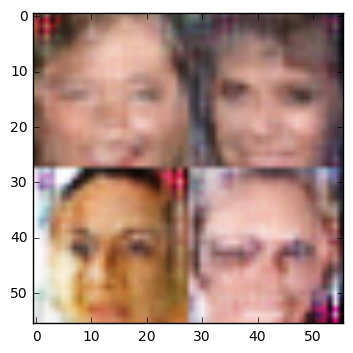

1.67064 0.379771 105600 2


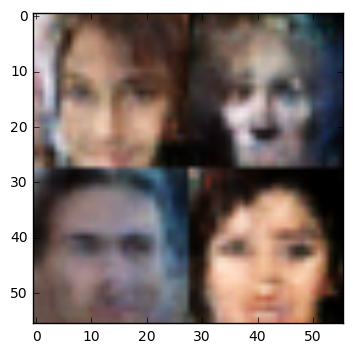

0.518919 2.04208 108800 2


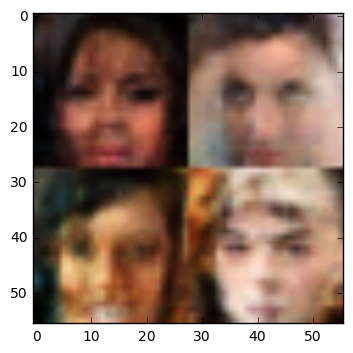

0.840213 1.44677 112000 2


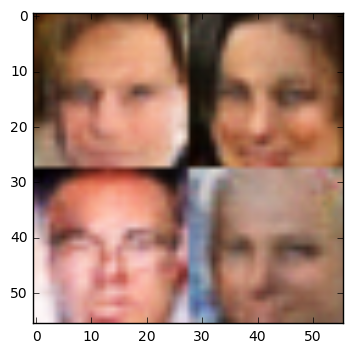

0.397243 3.79548 115200 2


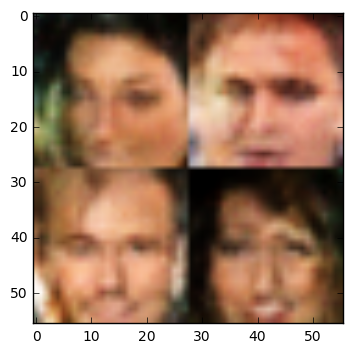

0.627739 1.64545 118400 2


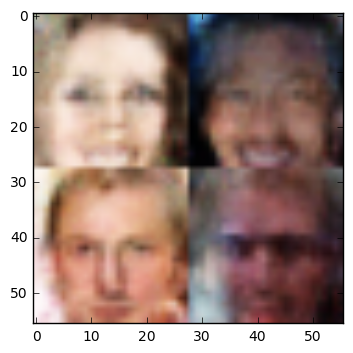

1.23266 0.571622 121600 2


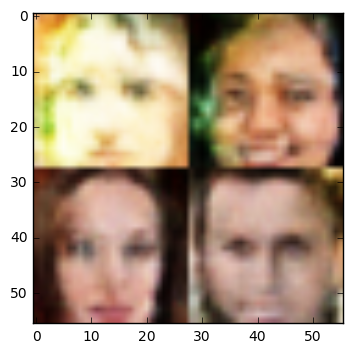

0.343506 8.24142 124800 2


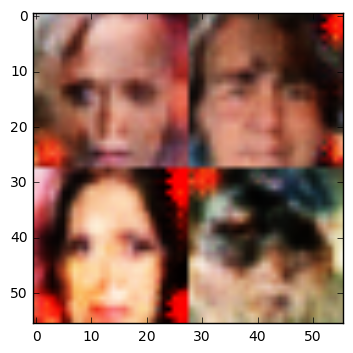

1.5082 2.93189 128000 2


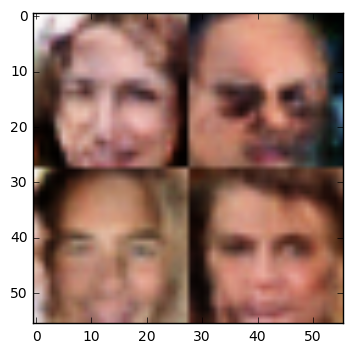

0.556395 1.82792 131200 2


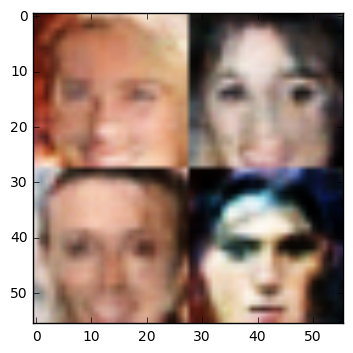

0.385377 3.66909 134400 2


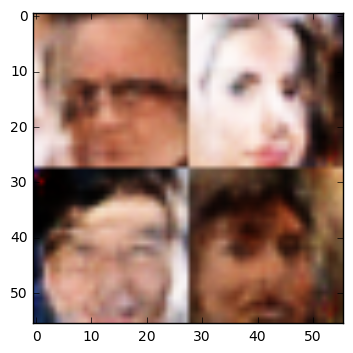

1.53837 0.450124 137600 2


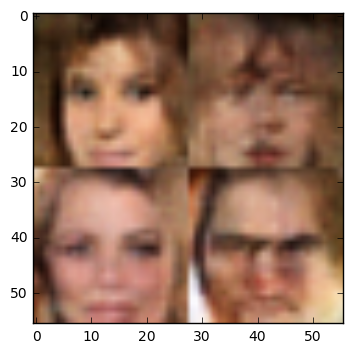

0.424963 3.10627 140800 2


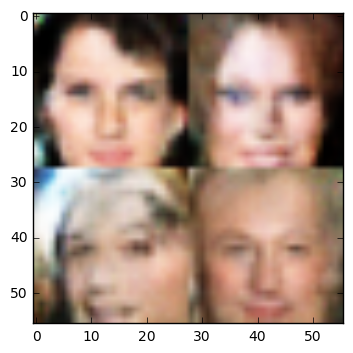

0.548647 2.16361 144000 2


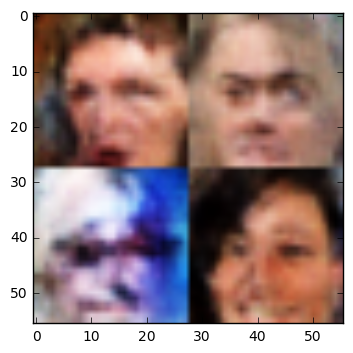

0.362655 3.93912 147200 2


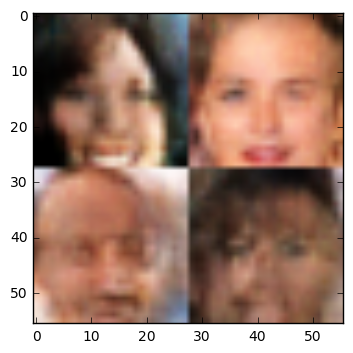

0.704674 1.93907 150400 2


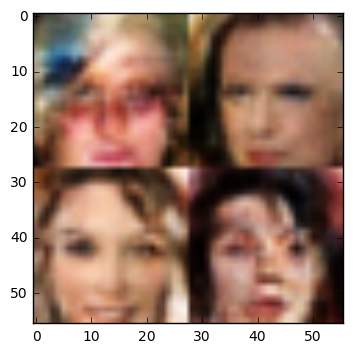

0.515375 1.96638 153600 2


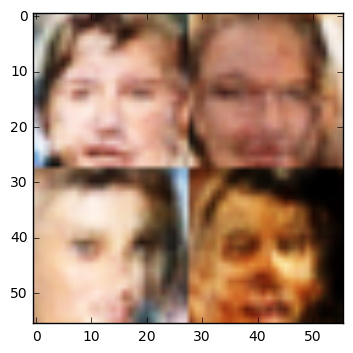

1.15122 2.27673 156800 2


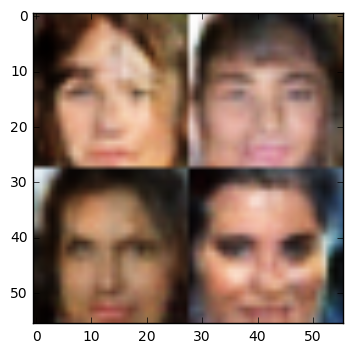

0.687868 1.38041 160000 2


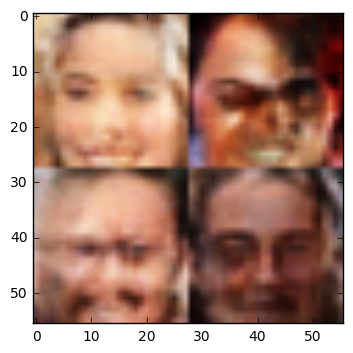

0.571868 2.14355 163200 2


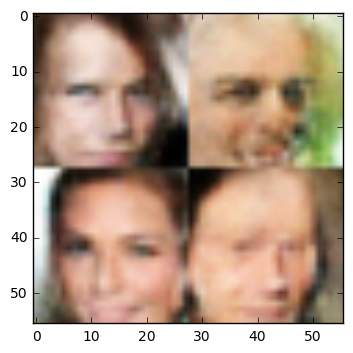

0.664496 2.05663 166400 2


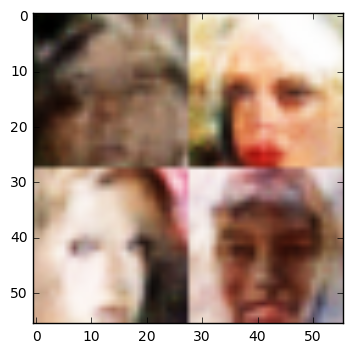

0.632167 2.30516 169600 2


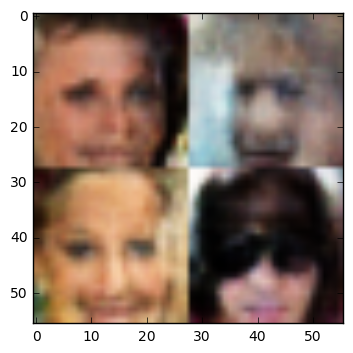

0.519997 2.10494 172800 2


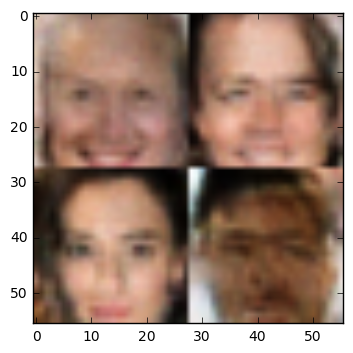

1.10035 0.725687 176000 2


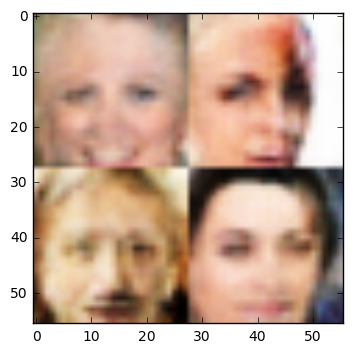

0.849049 2.10383 179200 2


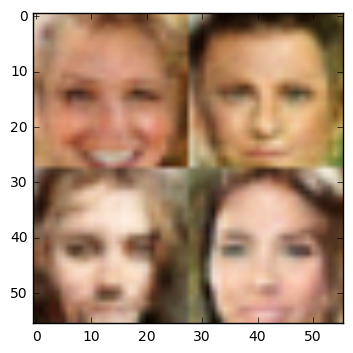

0.43672 4.12345 182400 2


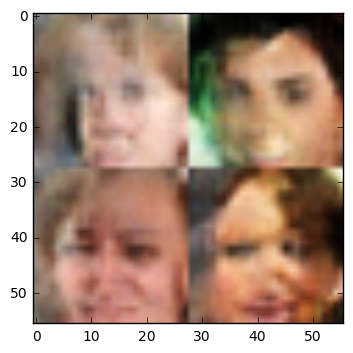

0.500332 2.08253 185600 2


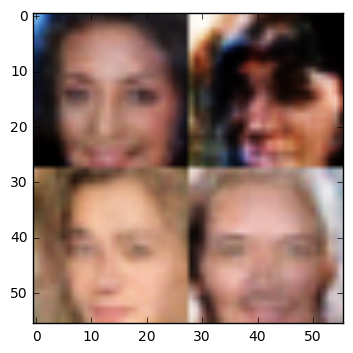

0.963567 2.03884 188800 2


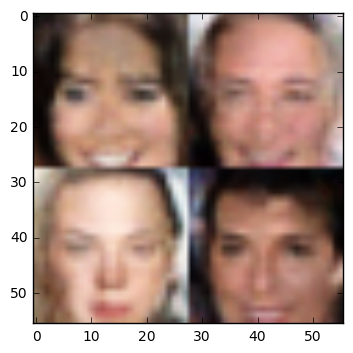

1.41777 0.505793 192000 2


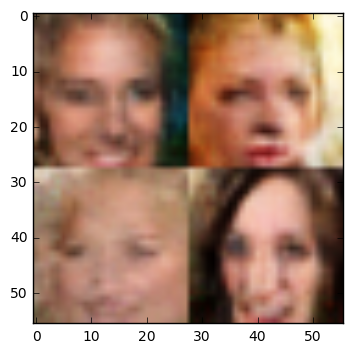

0.735056 1.25796 195200 2


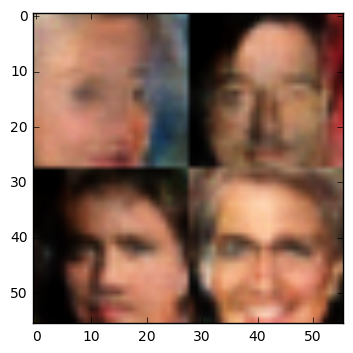

0.783915 1.88654 198400 2


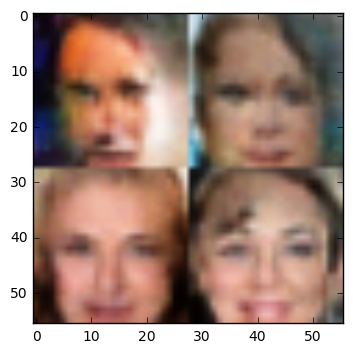

0.404483 3.41931 201600 2


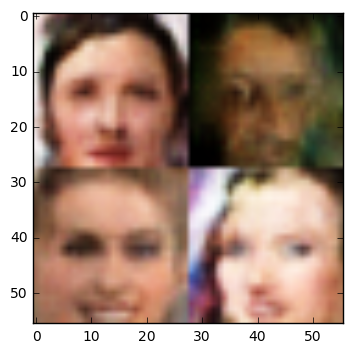

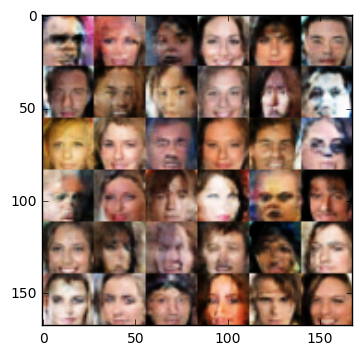

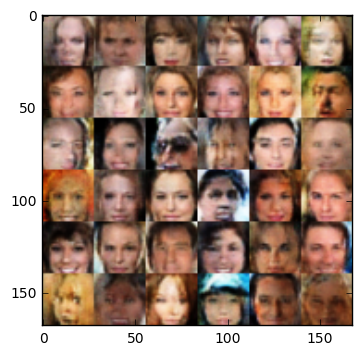

CPU times: user 1d 9h 25min 3s, sys: 1h 22min 15s, total: 1d 10h 47min 18s
Wall time: 4h 45min 14s


In [25]:
%%time

batch_size = 32
z_dim = 128
learning_rate = 0.0001
beta1 = 0.1


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.